DATASET            id diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  \
0      842302         M        17.99         10.38          122.80     1001.0   
1      842517         M        20.57         17.77          132.90     1326.0   
2    84300903         M        19.69         21.25          130.00     1203.0   
3    84348301         M        11.42         20.38           77.58      386.1   
4    84358402         M        20.29         14.34          135.10     1297.0   
..        ...       ...          ...           ...             ...        ...   
564    926424         M        21.56         22.39          142.00     1479.0   
565    926682         M        20.13         28.25          131.20     1261.0   
566    926954         M        16.60         28.08          108.30      858.1   
567    927241         M        20.60         29.33          140.10     1265.0   
568     92751         B         7.76         24.54           47.92      181.0   

     smoothness_mea

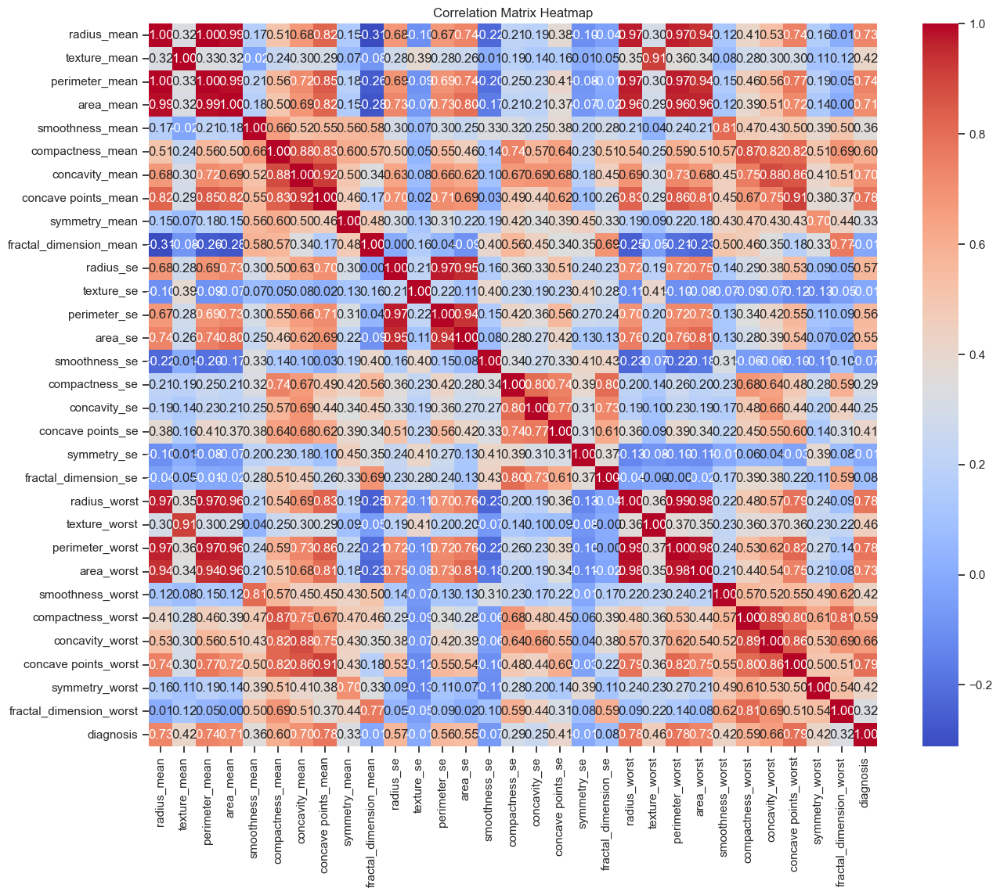

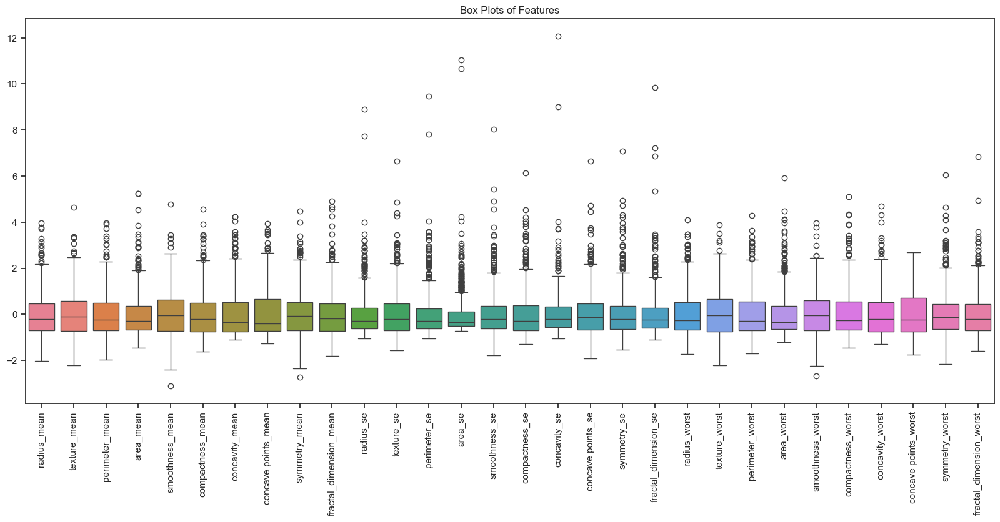

In [1]:
def main():

    import pandas as pd
    import numpy as np
    import matplotlib.pyplot as plt
    from sklearn.preprocessing import StandardScaler
    import seaborn as sns
    
   # STEP 1: Download the Dataset 
    dataset = pd.read_csv('data.csv')    
    print("DATASET", dataset)
    print("DATASET INFO", dataset.info())
    
    # STEP 2 : Reading the Dataset
    # Step 2a: Create a boolean DataFrame showing missing values (True/False)
    missing_values_dataframe = dataset.isna()
    print("BOOLEAN MISSING VALUE MASK:")
    print(missing_values_dataframe.head())  # Shows True where data is missing
    # Step 2b: Count total missing values per column
    missing_counts = missing_values_dataframe.sum()
    print("\nCOUNT OF MISSING VALUES PER COLUMN:")
    print(missing_counts)
    # Step 2c: Count total missing values in entire dataset
    # This will show how many missing (NaN) values each column has — see that Unnamed: 32 has all NaNs.
    total_missing =  missing_values_dataframe.values.sum()
    print("\nTOTAL MISSING VALUES IN DATASET:", total_missing)
    """
    Every real column (id, diagnosis, radius_mean, …, fractal_dimension_worst) has 0 missing values
    The last column, Unnamed: 32, has 569 missing values (one for every row)
    That means this column is completely empty and should be removed from your dataset.
    Drop only the all-NaN column (Unnamed: 32):
    """
    
    # STEP 3 — Dropping Unnecessary Columns - Drop the Missing Column
    dataset = dataset.drop(columns=["Unnamed: 32"])
    print("\nAFTER DROPPING MISSING COLUMN:")
    print(dataset.isnull().sum())
    print("DATASET", dataset)
    print("DATASET SHAPE:", dataset.shape)

    # STEP 4: Preprocessing
    # 4a: Encoding - Encode Categorical Features
    """
    Why: ML models can’t process strings — they need numerical values.
    In the dataset, the only categorical feature is diagnosis (M or B). Because it’s a binary categorical feature and diagnosis is a label column — a label encoder is appropriate 
    Convert diagnosis to numeric (e.g., M → 1, B → 0). Unique values (B,M) in alphabetical order maps to 0 & 1
    """
    dataset["diagnosis"] = dataset["diagnosis"].map({"M": 1, "B": 0})
    print("DATASET AFTER LABEL ENCODING", dataset)
    # 4b:Standardization is considered one method for normalization.
    """
    Normalization - it is normalizing the ranges of data fields in general. Standardization is considered one method for normalization.
    Standardization is useful when the values of the feature are normal distributed (i.e., the values follow the bell-shaped curve which also means the data is almost surrounding a common mean with most of the data condensed towards that mean and decreasing as the values move far from it).
    Note: Normalization/scaling/standardization is one method of normalization
    z(new value) = x(original value ) -   mean / variance 
    user scalaer from sklearn to calculate new values or use numpy to calculate mean, std dev and variane
    We train model on training data
    We hold back test data and test data is unseen data
    """

    # 4b: Standardization (exclude label column)
    print("\nENTIRE DATA FRAME BEFORE SCALING:")
    print(dataset)

    # Separate features and label
    # also drop unnecessary id col
    features = dataset.drop(columns=["diagnosis","id"])
    labels = dataset["diagnosis"]

    # Apply StandardScaler only to features
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(features)
    
    
    # Convert back to DataFrame with original column names
    features_scaled_df = pd.DataFrame(features_scaled, columns=features.columns)

    # Concatenate scaled features with labels
    data_refined_df = pd.concat([features_scaled_df, labels], axis=1)

    print("\nREFINED DATA (features scaled, label intact):")
    print(data_refined_df.head())
    
    # Save to CSV
    data_refined_df.to_csv("data_refined.csv", index=False)
    data = pd.read_csv("data_refined.csv")
    print("\n✅ FIRST 5 ROWS:")
    print(data.head())
    print("\n✅ LAST 5 ROWS:")
    print(data.tail())
    # 4c: Dealing with Nan values - see steps 2c & above
     
    # STEP 5: Visualization
    #  Load the preprocessed CSV
    dataset = pd.read_csv("data_refined.csv")
    # If the 'id' column exists, drop it for visualizations
    dataset_viz = dataset.drop(columns=["id"], errors='ignore')
    # Pair Plot - shows scatter plots between all feature pairs and histograms for each feature. It’s useful to see relationships and clusters.
    sns.set_theme(style="ticks", palette="pastel")
    # If you have the target column 'diagnosis', color by it
    sns.pairplot(dataset_viz, hue="diagnosis", diag_kind="hist")
    plt.suptitle("Pair Plot of Features", y=1.02)
    plt.show()
    """
    Notes:
    hue="diagnosis" colors malignant vs benign points differently
    diag_kind="hist" shows histograms along the diagonal  
    """
    # Correlation Matrix Heatmap - shows feature correlations, useful to detect highly correlated features.
    plt.figure(figsize=(15, 12))
    corr = dataset_viz.corr()  # correlation matrix
    sns.heatmap(corr, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
    plt.title("Correlation Matrix Heatmap")
    plt.show()
    """
    Notes:
    Correlation values close to 1 or -1 indicate strong positive/negative correlation
    """
    # Box Plots - help detect outliers and see feature distributions.
    plt.figure(figsize=(20, 8))
    sns.boxplot(data=dataset_viz.drop(columns=["diagnosis"], errors='ignore'))
    plt.xticks(rotation=90)
    plt.title("Box Plots of Features")
    plt.show()
   
main()